# Notebook Explore Data Analysis

In [1]:
import random
import pandas as pd
import numpy as np  
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from tqdm import tqdm
from PIL import Image

In [2]:
# Config
data_path = Path.cwd().parent / 'data' / 'Agricultural-crops'

## 1. Dataset structure & label distribution

In [3]:
# Dataset structure
classes = []
for path in data_path.iterdir():
    if path.is_dir():
        classes.append(path.name)
print(f"Classes: {classes}")
print(f"The number of classes: {len(classes)}")

Classes: ['Cucumber', 'Lemon', 'Olive-tree', 'sugarcane', 'rice', 'pineapple', 'almond', 'maize', 'sunflower', 'jowar', 'soyabean', 'mustard-oil', 'tomato', 'Cherry', 'coconut', 'cardamom', 'vigna-radiati(Mung)', 'Coffee-plant', 'Pearl_millet(bajra)', 'chilli', 'wheat', 'banana', 'tea', 'clove', 'papaya', 'Fox_nut(Makhana)', 'cotton', 'Tobacco-plant', 'jute', 'gram']
The number of classes: 30


In [4]:
# Label distribution
counts = []
for cls in classes:
    n = len(list((data_path/cls).glob("*")))
    counts.append({
        "class": cls,
        "count": n,
    })

# Create dataframe    
df_counts = pd.DataFrame(
    counts
)

print("\nTotal images:", df_counts["count"].sum())


Total images: 829


In [5]:
# Visualize dataframe
df_counts.sort_values(by= "count", ascending= False).head()

,class,count
18,Pearl_millet(bajra),39
27,Tobacco-plant,33
13,Cherry,32
26,cotton,32
7,maize,31


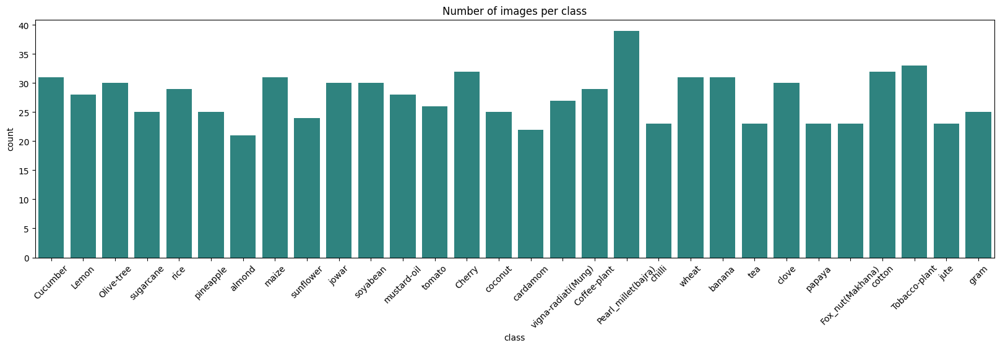

In [6]:
# Visualize images
plt.figure(figsize=(20, 5))
sns.barplot(
    x="class",
    y="count",
    data=df_counts,
    palette="viridis",
    hue=False,
    legend=False
)
plt.title("Number of images per class")
plt.xticks(rotation=45)
plt.show()

Conclusion: Classes are **fairly balanced**

## 2. Check image properties

In [7]:
img_shapes = []
bad_files = []
for cls in classes:
    for p in tqdm(list((data_path/cls).glob("*")), desc=f"Checking {cls}"):
        try:
            img = Image.open(p)
            img_shapes.append(img.size)  # (width, height)
        except Exception:
            bad_files.append(str(p))
print(f"Bad files: {len(bad_files)}")   
print("No corrupted files detected.")

Checking gram: 100%|██████████| 25/25 [00:00<00:00, 7997.07it/s]

Bad files: 0
No corrupted files detected.


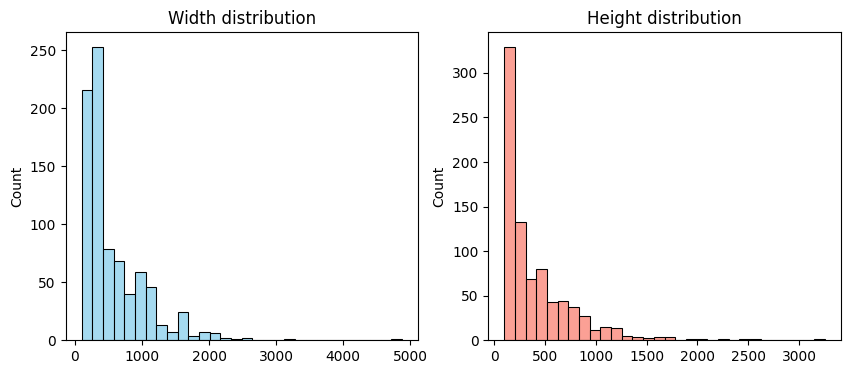

In [8]:
# Plot histogram of widths & heights
widths, heights = zip(*img_shapes)

plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
sns.histplot(widths, bins=30, color='skyblue')
plt.title("Width distribution")

plt.subplot(1,2,2)
sns.histplot(heights, bins=30, color='salmon')
plt.title("Height distribution")

plt.show()

There is **high variation** in image sizes -> Resize all images to a consistent shape

## 3. Sample visualization

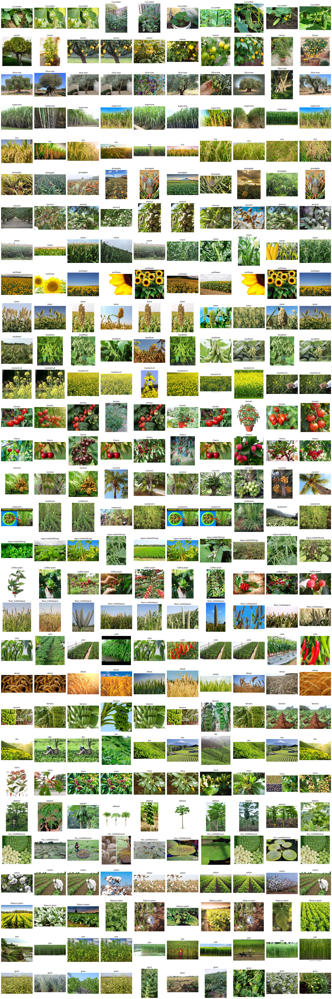

In [9]:
n_samples = 10
fig, axes = plt.subplots(len(classes), n_samples, figsize=(n_samples*3, len(classes)*3))
for i, cls in enumerate(classes):
    img_files = list((data_path/cls).glob("*"))
    for j in range(n_samples):
        p = random.choice(img_files)
        img = Image.open(p)
        axes[i,j].imshow(img)
        axes[i,j].set_title(cls)
        axes[i,j].axis("off")
plt.tight_layout()
plt.show()

## 4. Mean / Std RGB per channel

In [10]:
all_paths = []
for i in classes:
    for i in list((data_path/i).glob("*")):
        all_paths.append(str(i))

def compute_mean_std(image_paths):
    means, stds = [], []
    for p in tqdm(image_paths, desc="Computing mean/std"):
        img = np.array(Image.open(p).convert("RGB")) / 255.0
        means.append(img.mean(axis=(0,1)))
        stds.append(img.std(axis=(0,1)))
    return np.mean(means, axis=0), np.mean(stds, axis=0)

In [11]:
mean_rgb, std_rgb = compute_mean_std(all_paths)
print("Dataset mean (R,G,B):", mean_rgb)
print("Dataset std  (R,G,B):", std_rgb)

Computing mean/std: 100%|██████████| 829/829 [00:20<00:00, 41.29it/s] 

Dataset mean (R,G,B): [0.47759243 0.51541402 0.33296476]
Dataset std  (R,G,B): [0.22660034 0.2184544  0.23404391]


Brightness looks moderate and natural